# Introduction

In this post, we'll be using the *GALLOP* Python API to to enable us to visualise $\chi^2$ *hypersurfaces*. These hypersurfaces are functions of the molecular positions, orientations and conformations within the unit cell. As such, their dimensionality is typically high, meaning that we cant visualise them directly. However, we can visualise low-dimensional slices through them. We've seen an example of one of these slices [an earlier post](https://mspillman.github.io/blog/gallop/pxrd/python/2021/10/30/Introduction-to-GALLOP.html#Rationale-for-GALLOP).

We'll write a simple function that allows us to specify two or three vector directions, then sample $\chi^2$ at points on a grid between these directions. We'll also have a go at visualising the trajectories taken by particles initialised at each point on the grid as they are optimised with [Adam](https://mspillman.github.io/blog/gallop/pxrd/python/2021/10/30/Introduction-to-GALLOP.html#Adam), the default local optimiser in *GALLOP*.

For ease, we'll continue using verapamil hydrochloride as our structure of interest. You can download the *DASH* fit files and Z-matrices I'll be using [here](https://github.com/mspillman/blog/blob/master/_notebooks/files/verapamil_hydrochloride.zip).

## Choice of central point and slice directions

### Central point
Usually when we are trying to solve the crystal structure of an unknown small molecule, we are most concerned with finding the global minimum of the $\chi^2$ hypersurface. Therefore, we'll start off investigating the region around the global minimum. Due to the repeating nature of a crystallographic lattice, and symmetries within unit cells, there are infinitely many points that correspond to the global minimum of the hypersurface - therefore, the coordinates below may not be the same as coordinates you obtain in your own solutions of verapamil hydrochloride.

When *GALLOP* is used to solve a crystal structure, the degrees of freedom corresponding to the solution are automatically added to the CIF as comments. For example, here is the header of a CIF for verapamil hydrochloride:

```
# Generated using pymatgen and GALLOP
# GALLOP External Coords = [0.68394345,0.45950916,-0.114383094,0.2456631,-0.29722878,-0.10422839,0.3358067,0.7402369,0.7596887,-0.16798618
# GALLOP Internal Coords = -1.2276717,2.9165819,-0.96692395,-1.2034712,3.2261908,2.1036072,-3.2097023,-3.0328763,1.5661795,-0.0071008434,-0.1824131,-0.05715108,0.27950087
# Profile chisqd = 16.741
data_Verap_0006_56.244_chisqd_252_refs_3.6_mins.cif
```

So as long as we've been able to solve the crystal structure of interest with *GALLOP*, we'll have easy access to the coordinates of a global minimum point.

We can also plot around a random point on the hypersurface to give a comparison.

### Slice directions
In this post, we'll look at two options for plotting. The first and most obvious will be to plot along some of the degrees of freedom in the structure to see how they interact.

The other option will be to choose random unit vectors and slice the surface along them to get a feel for how all of the degrees of freedom interact. In high dimensional spaces, randomly generated pairs of vectors will be approximately orthogonal so it should be possible to get reasonable levels of independence between the axes in our plots.

# Data loading and functions

We need to import some libraries, then load our data and Z-matrices.

In [1]:
#| code-fold: true
import numpy as np
from gallop.structure import Structure
from gallop import tensor_prep
from gallop import zm_to_cart
from gallop import intensities
from gallop import chi2

mystructure = Structure(name="Verapamil", ignore_H_atoms=True)
mystructure.add_data("files/Verap.sdi", source="DASH")
mystructure.add_zmatrix("files/CURHOM_1.zmatrix", verbose=False)
mystructure.add_zmatrix("files/CURHOM_2.zmatrix", verbose=False)
mystructure.get_total_degrees_of_freedom(verbose=False)

# verapamil hydrochloride coordinates of global minimum from CIF.
g_external = np.array([0.68394345,0.45950916,-0.114383094,0.2456631,-0.29722878,
                        -0.10422839,0.3358067,0.7402369,0.7596887,-0.16798618])
g_internal = np.array([-1.2276717,2.9165819,-0.96692395,-1.2034712,3.2261908,
                        2.1036072,-3.2097023,-3.0328763,1.5661795,-0.0071008434,
                        -0.1824131,-0.05715108,0.27950087])

global_min = np.hstack([g_external,g_internal])

We also need a function to produce our vectors, grid and points at which to sample $\chi^2$.

In [2]:
#| code-fold: true
def get_vectors_and_angle(n_vectors, structure):
    # Generate random unit vectors and calculate the angles between them
    vectors = np.random.uniform(-1,1,(n_vectors, structure.total_degrees_of_freedom))
    vectors /= np.linalg.norm(vectors)
    if n_vectors == 2:
        angle = np.array(np.rad2deg(np.arccos(np.dot(vectors[0], vectors[1]))))
    else:
        angle = np.array([
            np.rad2deg(np.arccos(np.dot(vectors[0], vectors[1]))),
            np.rad2deg(np.arccos(np.dot(vectors[0], vectors[2]))),
            np.rad2deg(np.arccos(np.dot(vectors[1], vectors[2])))
            ])
    return vectors, angle

def get_points(structure, global_minimum, dims="random", n_vectors=2, n_points=50):
    if dims != "random":
        assert len(dims) in [2,3], "Number of dims must be 2 or 3"

    if dims == "random":
        # Randomly generate a set of n_vectors, and continue randomly generating
        # them until the angles between them are all in the range 88-92 degrees.
        vectors, angle = get_vectors_and_angle(n_vectors, structure)

        while np.abs(90 - angle).max() > 2:
            vectors, angle = get_vectors_and_angle(n_vectors, structure)

        gridpoints = [np.linspace(-1,1,n_points) for i in range(n_vectors)]
        print("Angle:",angle)
    else:
        vectors = np.zeros((len(dims), structure.total_degrees_of_freedom),
                            dtype=np.float32)

        gridpoints = []
        for i, d in enumerate(dims):
            global_minimum[d] *= 0
            vectors[i,d] = 1
            # If we are looking at the unit cell dimensions, then we want to
            # ensure that the range of data we plot captures the range the parameter
            # can take.
            if d < structure.total_position_degrees_of_freedom:
                gridpoints.append(np.linspace(0,1,n_points))
            elif d < structure.total_external_degrees_of_freedom:
                gridpoints.append(np.linspace(-1,1,n_points))
            else:
                gridpoints.append(np.linspace(-np.pi,np.pi,n_points))

    if len(gridpoints) == 2:
        xx, yy = np.meshgrid(gridpoints[0], gridpoints[1])
        points = global_minimum + xx.ravel().reshape(-1,1)*vectors[0] + yy.ravel().reshape(-1,1)*vectors[1]
        grid = [xx, yy]
    else:
        xx, yy, zz = np.meshgrid(gridpoints[0], gridpoints[1], gridpoints[2])
        points = global_minimum + xx.ravel().reshape(-1,1)*vectors[0] + yy.ravel().reshape(-1,1)*vectors[1] + zz.ravel().reshape(-1,1)*vectors[2]
        grid = [xx, yy, zz]

    external = points[:,:structure.total_external_degrees_of_freedom]
    internal = points[:,structure.total_external_degrees_of_freedom:]

    return external, internal, grid, gridpoints

Next we'll need a function to calculate $\chi^2$ at each point on our grid

In [3]:
#| code-fold: true
def get_chi_squared(mystructure, external, internal):
    tensors = tensor_prep.get_all_required_tensors(mystructure,
                            external=external, internal=internal, requires_grad=False)
    asymmetric_frac_coords = zm_to_cart.get_asymmetric_coords(**tensors["zm"])
    calculated_intensities = intensities.calculate_intensities(
                                asymmetric_frac_coords, **tensors["int_tensors"])
    chisquared = chi2.calc_int_chisqd(calculated_intensities, **tensors["chisqd_tensors"])

    chisquared = chisquared.detach().cpu().numpy()
    return chisquared

And lastly, a function to produce our plots

In [4]:
#| code-fold: true
from IPython.display import HTML
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode

display(HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
init_notebook_mode(connected=False)

def get_plot(chisquared, grid, gridpoints, dim1="x", dim2="y", percentile=50):

    if len(grid) == 2:
        # create figure
        fig = go.Figure()

        # Add surface trace
        fig.add_trace(
            go.Contour(x=gridpoints[0],
                        y=gridpoints[1],
                        z=chisquared.reshape(grid[0].shape),
                        colorscale="Inferno")
                    )

        # Update plot sizing
        fig.update_layout(
            width=700,
            height=600,
            autosize=False,
            margin=dict(t=0, b=0, l=0, r=0),
            template="plotly_white",
        )

        # Update 3D scene options
        fig.update_scenes(
            aspectratio=dict(x=1, y=1, z=0.8),
            aspectmode="manual"
        )

        # Add dropdown
        fig.update_layout(
            updatemenus=[
                dict(
                    buttons=list([
                        dict(
                            args=["type", "contour"],
                            label="Contour",
                            method="restyle"
                        ),
                        dict(
                            args=["type", "surface"],
                            label="3D Surface",
                            method="restyle"
                        )
                    ]),
                    direction="down",
                    pad={"r": 10, "t": 10},
                    showactive=True,
                    x=0.1,
                    xanchor="left",
                    y=1.1,
                    yanchor="top"
                ),
            ],
            xaxis=dict(
                title=dim1,
            ),
            yaxis=dict(
                title=dim2,
            ),
            scene_camera_eye=dict(x=-1, y=-3, z=0.9),
        )
    else:
        fig = go.Figure(data=go.Volume(
        x=grid[0].flatten(),
        y=grid[1].flatten(),
        z=grid[2].flatten(),
        value=chisquared,
        isomin=np.percentile(chisquared, 0),
        isomax=np.percentile(chisquared, percentile),
        opacity=0.1, # needs to be small to see through all surfaces
        surface_count=10, # needs to be a large number for good volume rendering
        reversescale=True,
        ))

        fig.update_layout(
            width=700,
            height=600,
            autosize=False,
            margin=dict(t=0, b=0, l=0, r=0),
            template="plotly_white",
        )

    return fig

# Plotting degrees of freedom
## 2D slices

Now that all of our functions are ready, let's first have a go at plotting some 2D slices through the surface, in the region of the global minimum.

In an earlier post, we looked at the verapamil position along $a$ and $c$. In this post, let's take a look at some of the quaternion components for the verapamil: q1 and q2.

In [5]:
#| code-fold: true

external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_min), dims=(6,7), n_points=100)
chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, dim1="Verapamil q1", dim2="Verapamil q2")

fig.show()

Now let's take a look at two of the torsion angles in verapamil, how about torsion 1 and 2, which correspond to the following torsions (using the CURHOM atom-labels):
1. N1 C9 C10 C11
2. C12 C11 C10 C9

In [6]:
#| code-fold: true
external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_min), dims=(10,11), n_points=100)

chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, dim1="N1 C9 C10 C11", dim2="C12 C11 C10 C9")
fig.show()

In the examples above, the surfaces that result are relatively smooth and have relatively few local minima.

As a comparison point, let's regenerate the plots above, but this time instead of visualising around the global minimum, let's use random coordinates instead.

In [7]:
#| code-fold: true
np.random.seed(314159)
random_pos = np.random.uniform(0,1,mystructure.total_position_degrees_of_freedom)
random_rot = np.random.uniform(-1,1,mystructure.total_rotation_degrees_of_freedom)
random_rot /= np.linalg.norm(random_rot)
random_tors = np.random.uniform(-np.pi,np.pi,mystructure.total_internal_degrees_of_freedom)

random_point = np.hstack([random_pos, random_rot, random_tors])
print("Random coordinates:", random_point)
figs = []
for dims in [[6,7, "Verapamil q1", "Verapamil q2"],
            [10,11, "N1 C9 C10 C11", "C12 C11 C10 C9"]]:
    external, internal, grid, gridpoints = get_points(mystructure, np.copy(random_point), dims=dims[:2], n_points=100)

    chisquared = get_chi_squared(mystructure, external, internal)

    figs.append(get_plot(chisquared, grid, gridpoints, dim1=dims[2], dim2=dims[3]))

for fig in figs:
    fig.show()

Random coordinates: [ 0.81792331  0.5510463   0.41977535  0.09869185  0.81102075  0.9673564
 -0.77218306  0.58012779  0.20160524  0.16291222 -0.04343231 -0.1460866
 -1.48303189 -1.19629038  2.56325063 -1.97929866 -1.95884954 -2.58621942
  2.3512614   0.89477677  2.21686588  0.20772398  2.38385342]


Things aren't looking quite so smooth as they were before!

This may partly be due to the scaling effect of no longer having the (very deep) global minimum present. To test that, let's replot our earlier torsion angle plot, but limit the minimum $\chi^2$ to the 5th percentile value. With this, we get about the same range of $\chi^2$ values as in the torsion angle plot around the random point. As we can see, the surface around the global minimum still looks more smooth, albeit with a few more shallow local minima now visible.

In [8]:
#| code-fold: true
external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_min), dims=(10,11), n_points=100)

chisquared = get_chi_squared(mystructure, external, internal)
chisquared[chisquared < np.percentile(chisquared, 5)] = np.percentile(chisquared, 5)

fig = get_plot(chisquared, grid, gridpoints, dim1="N1 C9 C10 C11", dim2="C12 C11 C10 C9")
fig.show()

## 3D slices

Now let's turn our attention to 3D slices through the surface. We'll use a [3D volume plot](https://plotly.com/python/3d-volume-plots/) from the plotly library to visualise three different dimensions at the same time. Due to the exponential increase in number of points we'll have to evaluate, the grid resolution will be coming down a bit! To make things a bit easier to see, I've reversed the colourscale used, so now orange and yellow represent regions of low $\chi^2$.

Let's see the position of the chloride ion within the unit cell, with all other degrees of freedom fixed at the global minimum. For clarity, we'll only visualise the isosurfaces below the fiftieth percentile of the $\chi^2$ values.

In [9]:
#| code-fold: true
external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_min), dims=(3,4,5), n_points=25)

chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, percentile=50)
fig.show()

Let's do the same thing for another selection of degrees of freedom, in this case, verapamil along $a$, the third quaternion component and the 4th torsion angle, which corresponds to C13 C12 C11 C10.

In [10]:
#| code-fold: true
external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_min), dims=(3,8,13), n_points=25)

chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, percentile=50)
fig.show()

It's a bit harder to tell what's going on in these plots - we have to infer the gradient from the coloured isosurfaces. However, to my eye, they still look relatively smooth. Let's take the same random point as before and plot the same 3D-slices and see if the slices look less smooth.

In [11]:
#| code-fold: true
figs = []
for dims in [[3,4,5],
            [3,8,13]]:
    external, internal, grid, gridpoints = get_points(mystructure, np.copy(random_point), dims=dims[:3], n_points=25)

    chisquared = get_chi_squared(mystructure, external, internal)

    figs.append(get_plot(chisquared, grid, gridpoints, percentile=50))

for fig in figs:
    fig.show()

Hard to tell! But to me they look more complex.

# Plotting random directions

So far, our plots have looked at slicing the hypersurface along known directions such as fractional coordinates or torsion angles. Now we'll generate some random (almost) orthogonal unit vectors and slice the surface in those directions.

In [12]:
#| code-fold: true
np.random.seed(42)
external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_min), n_vectors=2, n_points=100)

chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, dim1="Random 1", dim2="Random 2")
fig.show()

Angle: 91.52349584729872


In [13]:
#| code-fold: true
np.random.seed(43)
external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_min), n_vectors=3, n_points=25)

chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, percentile=50)
fig.show()

Angle: [89.56994448 91.07328889 91.30510482]


Let's repeat the above plots, this time centred around the random point we generated previously.

In [14]:
#| code-fold: true
np.random.seed(42)
external, internal, grid, gridpoints = get_points(mystructure, np.copy(random_point), n_vectors=2, n_points=100)

chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, dim1="Random 1", dim2="Random 2")
fig.show()

Angle: 91.52349584729872


In [15]:
#| code-fold: true
np.random.seed(43)
external, internal, grid, gridpoints = get_points(mystructure, np.copy(random_point), n_vectors=3, n_points=25)

chisquared = get_chi_squared(mystructure, external, internal)

fig = get_plot(chisquared, grid, gridpoints, percentile=50)
fig.show()

Angle: [89.56994448 91.07328889 91.30510482]


# Trajectories

Now we'll have a go at visualising the paths taken by the particles as they are optimised. We will limit ourselves to 2D slices for ease.

*GALLOP* actually includes a convenience function for recording the trajectories during the local optimisation steps - just add:
```python
minimiser_settings["save_trajectories"] = True
```
to the minimiser settings before calling the minimise function, and the result dictionary will have an entry under the key ```trajectories```.

However, we'll need some slightly different characteristics for our plotting: we need a minimisation function that allows us to fix all of the degrees of freedom *other than the ones we are plotting* or allow all of the degrees of freedom to refine as usual.

## Minimisation function

In [16]:
#| code-fold: true
import tqdm
import torch

def minimise(structure, external, internal, dims, fix=True, n_iterations=100, lr=0.01):

    trajectories = []

    if fix:
        tensors = tensor_prep.get_all_required_tensors(structure,
                            external=external, internal=internal,
                            requires_grad=False)
        grid = torch.from_numpy(np.hstack([external, internal])[:,dims]
                                ).type(torch.float32).cuda()
        grid.requires_grad = True
        alldof = torch.cat([tensors["zm"]["external"],
                            tensors["zm"]["internal"]], dim=-1)
        optimizer = torch.optim.Adam([grid], lr=lr, betas=[0.9,0.9])
    else:
        tensors = tensor_prep.get_all_required_tensors(structure,
                            external=external, internal=internal,
                            requires_grad=True)
        optimizer = torch.optim.Adam([tensors["zm"]["external"],
                                    tensors["zm"]["internal"]],
                                    lr=lr, betas=[0.9,0.9])
    local_iters = range(n_iterations)
    for j in local_iters:
        # Zero the gradients before each iteration otherwise they accumulate
        optimizer.zero_grad()
        if fix:
            grid_dofs = torch.cat([alldof[:,:dims[0]],
                                    grid[:,0].unsqueeze(1),
                                    alldof[:,dims[0]+1:dims[1]],
                                    grid[:,1].unsqueeze(1),
                                    alldof[:,dims[1]+1:]
                                    ], dim=-1)
            tensors["zm"]["external"] = grid_dofs[:,:structure.total_external_degrees_of_freedom]
            tensors["zm"]["internal"] = grid_dofs[:,structure.total_external_degrees_of_freedom:]
        asymmetric_frac_coords = zm_to_cart.get_asymmetric_coords(**tensors["zm"])
        calculated_intensities = intensities.calculate_intensities(
                                asymmetric_frac_coords, **tensors["int_tensors"])
        chisquared = chi2.calc_int_chisqd(calculated_intensities, **tensors["chisqd_tensors"])

        trajectories.append([tensors["zm"]["external"].detach().cpu().numpy(),
                            tensors["zm"]["internal"].detach().cpu().numpy(),
                            chisquared.detach().cpu().numpy()])
        # For the last iteration, don't step the optimiser, otherwise the chi2
        # value won't correspond to the DoFs
        if j != n_iterations - 1:
            L = torch.sum(chisquared)
            L.backward()
            optimizer.step()

    return trajectories

We'll also need a function to plot the resultant trajectories. It'll be useful to compare the slice of the surface before optimisation to the starting points that reached a solution by the end.

In [17]:
#| code-fold: true
import matplotlib.pyplot as plt

def plot_trajectories(mystructure, dims, global_minimum, lr=0.01, fix=True, n_iterations=100, n_points=50):

    external, internal, grid, gridpoints = get_points(mystructure, np.copy(global_minimum),
                                            dims=dims, n_points=n_points)

    trajectories = minimise(mystructure, external, internal, dims, fix=fix, 
                                                n_iterations=n_iterations, lr=lr)

    coords = []
    chi2s = []
    for t in trajectories:
        coords.append(np.hstack(t[:2])[:,dims])
        chi2s.append(t[2])
    coords = np.dstack(coords)

    fig, ax = plt.subplots(1,3,figsize=(44,12))
    ax[0].set_title("$\\chi^2$ surface")
    ax[0].contour(gridpoints[0], gridpoints[0], chi2s[0].reshape(grid[0].shape),
                    cmap="viridis", levels=20)

    chi2temp = chi2s[-1] - chi2s[-1].min()
    col=plt.cm.viridis(chi2temp/chi2s[-1].max())
    col

    ax[1].set_title("Particle trajectories")
    ax[1].scatter(coords[:,0,0], coords[:,1,0], color=col[0], s=10, alpha=.125)

    for i in range(coords.shape[0]):
        ax[1].plot(coords[i,0,:], coords[i,1,:], color=col[i], alpha=0.125)

    percent_solved = np.around(100*(chi2s[-1]<60).sum()/chi2s[-1].shape[0], 1)
    ax[2].set_title(f"Final $\\chi^2$ - {percent_solved} % solved")
    ax[2].contourf(gridpoints[0], gridpoints[0], chi2s[-1].reshape(grid[0].shape),
                    cmap="viridis", levels=20)
    plt.show()
    return coords, chi2s, grid, gridpoints

Let's now visualise the trajectories taken if we slice along the verapamil position along $a$ and $b$, as well as torsion 1 and torsion 2. The upper plot in each case shows the trajectories if all of the degrees of freedom other than those being plotted are fixed. The lower plot shows the trajectories taken if everything is allowed to refine (as would be normal in *GALLOP*).

The plots might appear a little small on the blog - if you want larger views, right click on the image and open them in a new tab.

(3, 4) others fixed


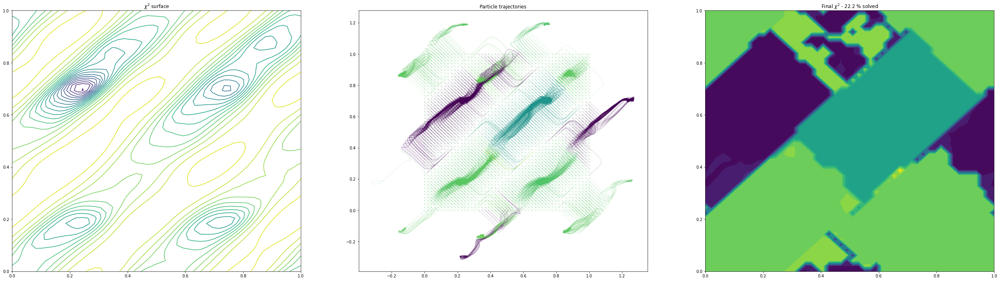

(3, 4) others free


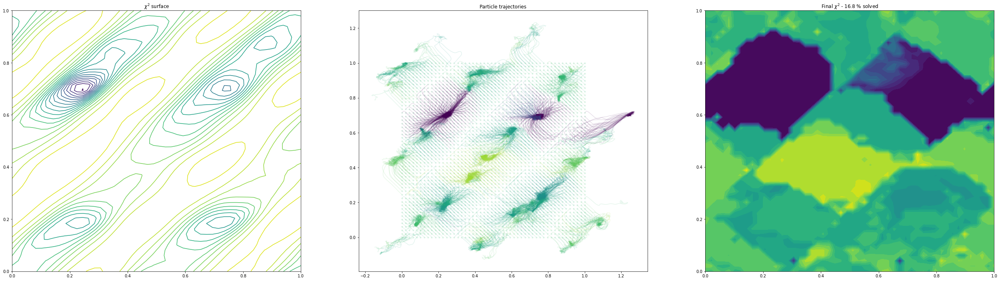

(10, 11) others fixed


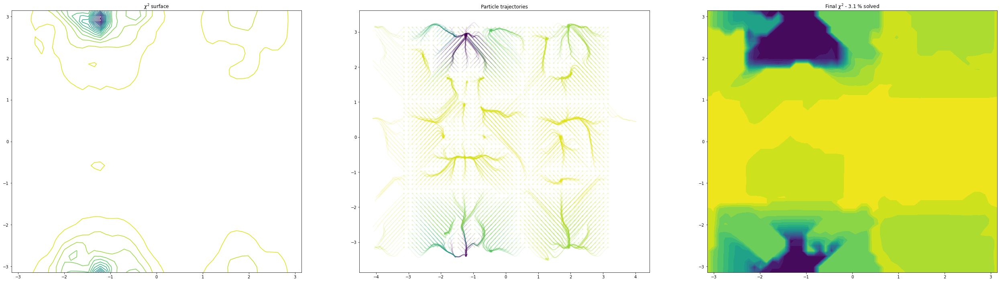

(10, 11) others free


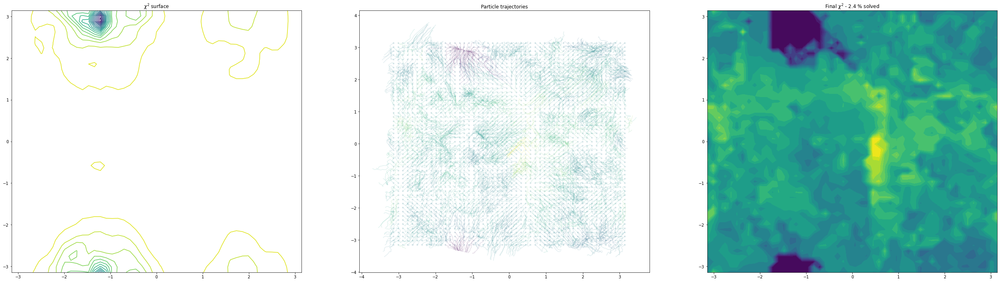

In [18]:
#| code-fold: true
dims=(3,4)
print(dims,"others fixed")
fixed_trajectories_34 = plot_trajectories(mystructure, dims, np.copy(global_min), lr=0.01, fix=True, n_iterations=100, n_points=50)

print(dims, "others free")
free_trajectories_34 = plot_trajectories(mystructure, dims, np.copy(global_min), lr=0.01, fix=False, n_iterations=100, n_points=50)

dims=(10,11)
print(dims,"others fixed")
fixed_trajectories_1011 = plot_trajectories(mystructure, dims, np.copy(global_min), lr=0.01, fix=True, n_iterations=100, n_points=50)

print(dims, "others free")
free_trajectories_1011 = plot_trajectories(mystructure, dims, np.copy(global_min), lr=0.01, fix=False, n_iterations=100, n_points=50)

As we can see, as we allow the other degrees of freedom to refine, we end up with different behaviour. In the example of the fractional coordinates (dims = 3,4) can now see two points within the unit cell that constitute a global minimum after refinement - this is because in the second plot, the chloride ion is free to move to accommodate the different positions of the verapamil molecule.

Another point of interest is the effects of momentum in the Adam optimiser are clearly visible - the trajectories in some cases backtrack after moving in a particular direction for a while. This is because momentum has carried them "uphill". This property can allow the local optimisation algorithm in *GALLOP* to escape shallow local minima, as well as pass quickly through flat regions of the hypersurface.

Lastly, let's animate the trajectories!

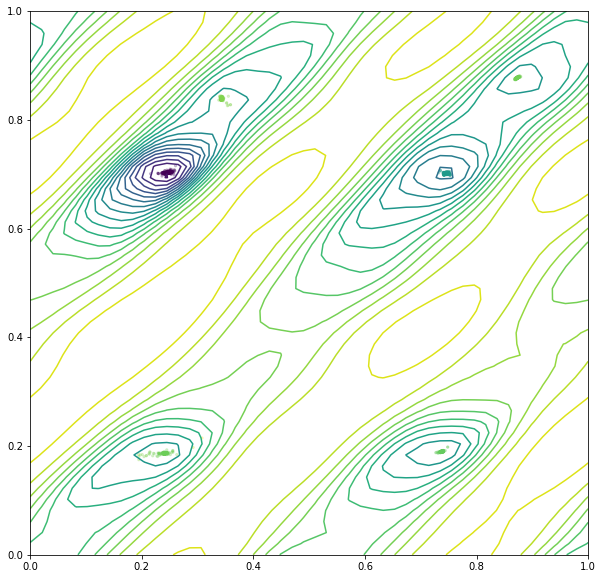

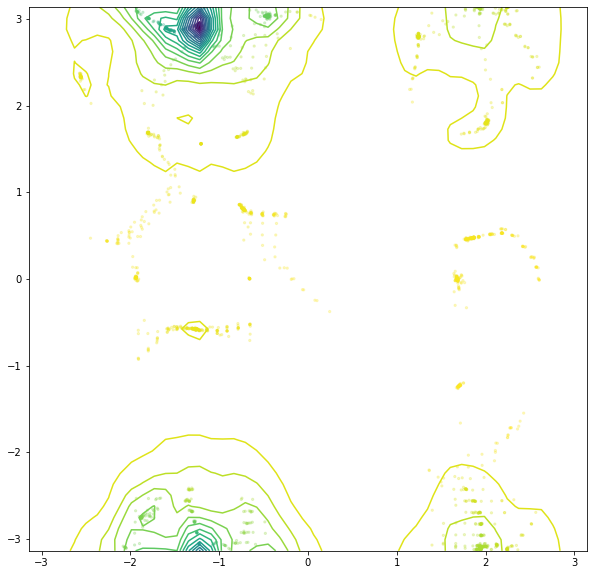

In [24]:
#| output: false
#| code-fold: true

from matplotlib import animation

def generate_animation(coords, chi2s, grid, gridpoints, name="fig.gif", type="frac"):
    # First set up the figure, the axis, and the plot element we want to animate
    fig = plt.figure(figsize=(10,10))
    ax = plt.axes(xlim=(gridpoints[0].min(), gridpoints[0].max()),
                ylim=(gridpoints[1].min(), gridpoints[1].max()))

    ax.contour(gridpoints[0], gridpoints[1], chi2s[0].reshape(grid[0].shape), cmap="viridis", levels=20)

    scatter = ax.scatter(coords.T[0, 0, :], coords.T[0, 1, :], c=chi2s[-1],
                        s=5, alpha=0.25)


    # animation function.  This is called sequentially
    def animate(i, coords, chi2s):
        #scatter.set_offsets(coords.T[i, :, :].T)
        if type == "frac":
            scatter.set_offsets(coords.T[i, :, :].T % 1)
        elif type == "torsion":
            scatter.set_offsets(np.arctan2(np.sin(coords.T[i, :, :].T), np.cos(coords.T[i, :, :].T)))
        #scatter.set_array(chi2s[i])
        scatter.set_array(chi2s[-1])
        return scatter,


    ani = animation.FuncAnimation(fig, animate, frames=range(coords.T.shape[0]), blit=True,
                                    fargs=(coords, chi2s), interval=100,)

    ani.save(name)
    #plt.show()
    return None

generate_animation(*fixed_trajectories_34, name="images/animation_34.gif", type="frac")
generate_animation(*fixed_trajectories_1011, name="images/animation_1011.gif", type="torsion")

Verapamil along a and b
![](images/animation_34.gif)

Verapamil torsion 1 and 2
![](images/animation_1011.gif)


Things seem to move much more slowly in the torsion angle example - I suspect this is because the gradient on the "flat" region is low enough that it takes a while for the particles to pick up speed!

# Conclusions

Using *GALLOP* and relatively little boilerplate code, it's possible to easily plot slices through $\chi^2$ hypersurfaces, and visialise trajectories taken by the local optimiser.

In a future post, we'll look at trying to extend our visualisation to full *GALLOP* solutions including the particle swarm optimmisation steps. We'll make use of dimensionality reduction techniques such as Principal Component Analysis and Uniform Manifold Approximation to allow us to visualise all of the degrees of freedom at once!